In [1]:
from src.onmf import Online_NMF, update_code_within_radius
import itertools
import numpy as np
from PIL import Image
from skimage.transform import downscale_local_mean
from sklearn.feature_extraction.image import extract_patches_2d
from sklearn.feature_extraction.image import reconstruct_from_patches_2d
from tensorly import unfold as tl_unfold
from tqdm import trange
from time import time
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cv2

In [2]:
def read_video_as_array(path, scale=1):
        cap = cv2.VideoCapture(path)
        frameCount = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
        frameWidth = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        frameHeight = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
        
        X = np.empty((frameCount, frameHeight//scale, frameWidth//scale, 3), np.dtype('uint8'))

        fc = 0
        ret = True

        while (fc < frameCount and ret):
            ret, frame = cap.read()
            [w, h, c] = frame.shape

            #syntax: cv2.resize(img, (width, height))
            img = cv2.resize(frame,(h//scale, w//scale))
            X[fc] = img
            fc += 1

        cap.release()
        
        X = np.moveaxis(X,0,-1)
        
        print('data.shape (height, width, color, time) = ', X.shape)  ### frames * width * height * 3
        return X
    

In [29]:
def train_dict(X, 
               sequential=True, 
               n_components=5, 
               forgetting_param=1,
               time_stride=1,
               random_ordering=False):
        print('training dictionaries from video X..')
        '''
        X.shape = [x, y, 3, time]
        '''
        
        X_unfolded = X.reshape(-1,X.shape[-1])
        print('X_unfolded.shape', X_unfolded.shape)
        W_list = []
        At = []
        Bt = []
        code = np.ones(shape=(n_components, 1))
        for t in trange(0,X.shape[-1],time_stride):
            data = X_unfolded[:,t:t+time_stride]
            if random_ordering:
                s = np.random.choice(np.arange(0,X.shape[-1]-time_stride))
                data = X_unfolded[:,s:s+time_stride]
            #if time_stride==1:
            #    data = data[:,np.newaxis]
            
            if t == 0:
                onmf = Online_NMF(data,
                                  n_components=n_components,
                                  iterations=5,
                                  batch_size=time_stride,
                                  ini_dict=None,
                                  ini_agg=None,
                                  history=0,
                                  beta=forgetting_param,
                                  alpha=None)
                W, aggregates, H = onmf.train_dict()
               
            else:
                onmf = Online_NMF(data,
                                  n_components=n_components,
                                  iterations=5,
                                  batch_size=time_stride,
                                  ini_dict=W,
                                  ini_agg = aggregates,
                                  beta=forgetting_param,
                                  history=onmf.history,
                                  alpha=None)
                W, aggregates, H = onmf.train_dict()
            W0 = W.reshape(X.shape[0],X.shape[1],X.shape[2],n_components)
            W_list.append(W0)
            
        print('dict_shape:', W0.shape)
        print('code_shape:', code.shape)
        return W_list

In [18]:
from moviepy.editor import ImageSequenceClip
from IPython.display import display, Image

def dict_list2gif(W_list, filename, fps=20):
    frames = []
    for i in np.arange(len(W_list)):
        a = W_list[i]
        b = np.concatenate([a[...,j] for j in range(a.shape[-1]) ], axis=1)
        frames.append(b/np.max(b))
    frames = np.asarray(frames)*255
    frames = frames.astype(np.uint8)
    
    clip = ImageSequenceClip(list(frames), fps=fps)
    clip.write_gif(filename, fps=fps)
    print('frames.shape',frames.shape)
    #Image('test.gif')
    return frames

In [23]:
X = read_video_as_array("Data/Video/giphy-2.gif", scale=1)

data.shape (height, width, color, time) =  (200, 254, 3, 38)


 11%|█         | 2/19 [00:00<00:01, 15.61it/s]

training dictionaries from video X..
X_unfolded.shape (152400, 38)


t:  10%|█         | 2/20 [00:00<00:01, 17.32it/s, now=None]

dict_shape: (200, 254, 3, 5)
code_shape: (5, 1)
MoviePy - Building file bruce1.gif with imageio.


frames.shape (19, 200, 1270, 3)


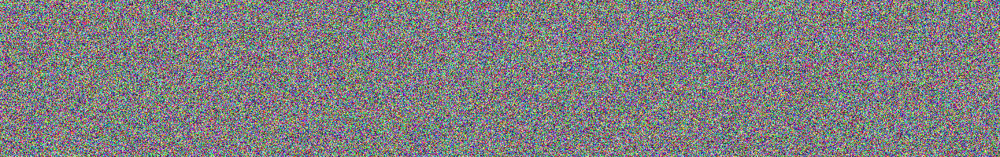

In [24]:
W_list = train_dict(X, n_components=5, forgetting_param=0.1, time_stride=2)
filename="bruce1.gif"
frames = dict_list2gif(W_list, filename, fps=10)
Image(filename)

 11%|█         | 2/19 [00:00<00:01, 13.47it/s]

training dictionaries from video X..
X_unfolded.shape (152400, 38)


t:   0%|          | 0/20 [00:00<?, ?it/s, now=None]

dict_shape: (200, 254, 3, 5)
code_shape: (5, 1)
MoviePy - Building file bruce2.gif with imageio.


frames.shape (19, 200, 1270, 3)


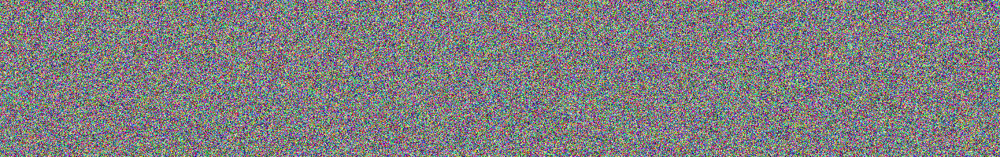

In [25]:
W_list = train_dict(X, n_components=5, forgetting_param=1, time_stride=2)
filename="bruce2.gif"
frames = dict_list2gif(W_list, filename, fps=10)
Image(filename)

  5%|▌         | 1/19 [00:00<00:01,  9.76it/s]

training dictionaries from video X..
X_unfolded.shape (152400, 38)


t:   0%|          | 0/20 [00:00<?, ?it/s, now=None]

dict_shape: (200, 254, 3, 5)
code_shape: (5, 1)
MoviePy - Building file bruce3.gif with imageio.


frames.shape (19, 200, 1270, 3)


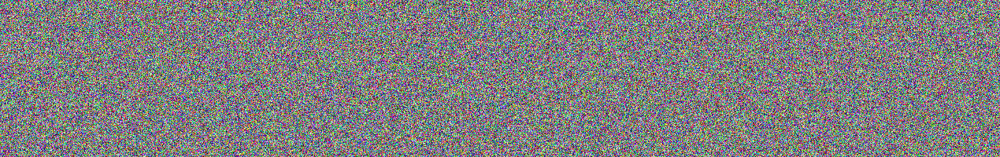

In [31]:
W_list = train_dict(X, n_components=5, forgetting_param=0.1, time_stride=2, random_ordering=True)
filename="bruce3.gif"
frames = dict_list2gif(W_list, filename, fps=10)
Image(filename)

  0%|          | 0/19 [00:00<?, ?it/s]

training dictionaries from video X..
X_unfolded.shape (152400, 38)


t:   0%|          | 0/20 [00:00<?, ?it/s, now=None]

dict_shape: (200, 254, 3, 5)
code_shape: (5, 1)
MoviePy - Building file bruce4.gif with imageio.


frames.shape (19, 200, 1270, 3)


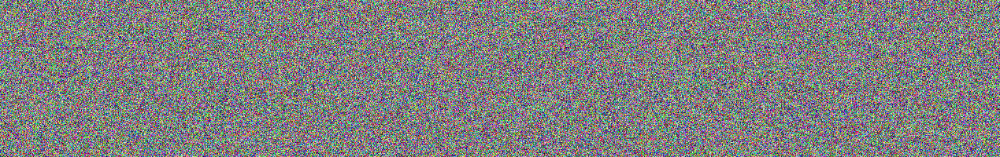

In [32]:
W_list = train_dict(X, n_components=5, forgetting_param=1, time_stride=2, random_ordering=True)
filename="bruce4.gif"
frames = dict_list2gif(W_list, filename, fps=10)
Image(filename)